In [2]:
# import key libraries
import pandas as pd
import plotly.express as px
from copy import copy
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow import keras
import plotly.offline as py
import plotly.express as px
import plotly.graph_objects as go


In [4]:
# Data Source: https://www.kaggle.com/berkeleyearth/climate-change-earth-surface-temperature-data/notebooks?datasetId=29&sortBy=voteCount

# Exploratory Data Analysis

In [3]:
temperature_df = pd.read_csv(r'data/GlobalLandTemperaturesByCountry.csv')
temperature_df['Country'].unique()
temperature_df.isnull().sum()
temperature_df.info()
temperature_df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 577462 entries, 0 to 577461
Data columns (total 4 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   dt                             577462 non-null  object 
 1   AverageTemperature             544811 non-null  float64
 2   AverageTemperatureUncertainty  545550 non-null  float64
 3   Country                        577462 non-null  object 
dtypes: float64(2), object(2)
memory usage: 17.6+ MB


,AverageTemperature,AverageTemperatureUncertainty
count,544811.000000,545550.000000
mean,17.193354,1.019057
std,10.953966,1.201930
min,-37.658000,0.052000
25%,10.025000,0.323000
50%,20.901000,0.571000
75%,25.814000,1.206000
max,38.842000,15.003000


In [5]:
# Do groupby country to see the count of values available for each country
country_group_df = temperature_df.groupby(by = 'Country').count().reset_index('Country').rename(columns={'AverageTemperature':'AverageTemperatureCount','AverageTemperatureUncertainty' : 'AverageTemperatureUncertaintyCount'})
country_group_df

,Country,dt,AverageTemperatureCount,AverageTemperatureUncertaintyCount
0,Afghanistan,2106,2085,2085
1,Africa,1965,1894,1894
2,Albania,3239,3166,3166
3,Algeria,2721,2702,2702
4,American Samoa,1761,1629,1629
...,...,...,...,...
238,Western Sahara,2721,2536,2536
239,Yemen,1653,1649,1649
240,Zambia,1965,1690,1690
241,Zimbabwe,1965,1725,1725


In [7]:
import plotly.express as px
fig = px.bar(country_group_df, x = 'Country', y = 'AverageTemperatureCount')
fig.show()

In [8]:
fig = px.bar(country_group_df, x = 'Country', y = 'AverageTemperatureUncertaintyCount')
fig.show()

In [9]:
# Plot the histogram of AverageTemperatureCount
fig = px.histogram(country_group_df, x = "AverageTemperatureCount")
fig.show()

In [10]:
# Plot the histogram of AverageTemperatureUncertainityCount
fig = px.histogram(country_group_df, x = "AverageTemperatureUncertaintyCount")
fig.show()

# Cleaning Data

In [12]:
country_group_df[(country_group_df['AverageTemperatureCount'] < 1500) | (country_group_df['AverageTemperatureUncertaintyCount'] < 1500)]

,Country,dt,AverageTemperatureCount,AverageTemperatureUncertaintyCount
8,Antarctica,764,0,739
73,Federated States Of Micronesia,1427,1364,1364
80,French Southern And Antarctic Lands,788,783,783
91,Guam,1329,1328,1328
98,Heard Island And Mcdonald Islands,788,783,783
161,Northern Mariana Islands,1329,1328,1328
204,South Georgia And The South Sandwich Isla,1666,1474,1474


In [14]:
# Find the countries that have less than 1500 data points
countries_with_less_data = country_group_df[(country_group_df['AverageTemperatureCount'] < 1500) | (country_group_df['AverageTemperatureUncertaintyCount'] < 1500)]
countries_with_less_data = countries_with_less_data['Country'].tolist()

In [15]:
~temperature_df['Country'].isin(countries_with_less_data)

0         True
1         True
2         True
3         True
4         True
          ... 
577457    True
577458    True
577459    True
577460    True
577461    True
Name: Country, Length: 577462, dtype: bool

In [16]:
# Remove the countries with less data points
temperature_df = temperature_df[~temperature_df['Country'].isin(countries_with_less_data)]

In [18]:
# Reset the index
temperature_df.reset_index(inplace = True, drop = True)
temperature_df

,dt,AverageTemperature,AverageTemperatureUncertainty,Country
0,1743-11-01,4.384,2.294,Åland
1,1743-12-01,NaN,NaN,Åland
2,1744-01-01,NaN,NaN,Åland
3,1744-02-01,NaN,NaN,Åland
4,1744-03-01,NaN,NaN,Åland
...,...,...,...,...
569366,2013-05-01,19.059,1.022,Zimbabwe
569367,2013-06-01,17.613,0.473,Zimbabwe
569368,2013-07-01,17.000,0.453,Zimbabwe
569369,2013-08-01,19.759,0.717,Zimbabwe


In [19]:
# Fill the missing values for average temperatures by doing rolling average on past 730 days
temperature_df['AverageTemperature'] = temperature_df['AverageTemperature'].fillna(temperature_df['AverageTemperature'].rolling(730, min_periods = 1).mean())

In [21]:
# Fill the missing values for average temperature uncertainty by doing rolling average on past 730 days
temperature_df['AverageTemperatureUncertainty']= temperature_df['AverageTemperatureUncertainty'].fillna(temperature_df['AverageTemperatureUncertainty'].rolling(730, min_periods=1).mean())

In [22]:
temperature_df.isna().sum()

dt                               0
AverageTemperature               0
AverageTemperatureUncertainty    0
Country                          0
dtype: int64

In [23]:
# Check the unique countries
temperature_df['Country'].unique()

array(['Åland', 'Afghanistan', 'Africa', 'Albania', 'Algeria',
       'American Samoa', 'Andorra', 'Angola', 'Anguilla',
       'Antigua And Barbuda', 'Argentina', 'Armenia', 'Aruba', 'Asia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Baker Island', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium',
       'Belize', 'Benin', 'Bhutan', 'Bolivia',
       'Bonaire, Saint Eustatius And Saba', 'Bosnia And Herzegovina',
       'Botswana', 'Brazil', 'British Virgin Islands', 'Bulgaria',
       'Burkina Faso', 'Burma', 'Burundi', "Côte D'Ivoire", 'Cambodia',
       'Cameroon', 'Canada', 'Cape Verde', 'Cayman Islands',
       'Central African Republic', 'Chad', 'Chile', 'China',
       'Christmas Island', 'Colombia', 'Comoros',
       'Congo (Democratic Republic Of The)', 'Congo', 'Costa Rica',
       'Croatia', 'Cuba', 'Curaçao', 'Cyprus', 'Czech Republic',
       'Denmark (Europe)', 'Denmark', 'Djibouti', 'Dominica',
       'Dominican Republic', 'Ecuador', 'Egypt'

In [24]:
# Check for the presence of other version of same country
duplicates = []
for i in temperature_df['Country'].unique():
    if '(' in i:
        duplicates.append(i)
duplicates

['Congo (Democratic Republic Of The)',
 'Denmark (Europe)',
 'Falkland Islands (Islas Malvinas)',
 'France (Europe)',
 'Netherlands (Europe)',
 'United Kingdom (Europe)']

In [25]:
# replace the duplicates
temperature_df = temperature_df.replace(duplicates, ['Congo', 'Denmark','Falkland Islands','France','Netherlands','United Kingdom'])

In [26]:
temperature_df['Country'].unique()

array(['Åland', 'Afghanistan', 'Africa', 'Albania', 'Algeria',
       'American Samoa', 'Andorra', 'Angola', 'Anguilla',
       'Antigua And Barbuda', 'Argentina', 'Armenia', 'Aruba', 'Asia',
       'Australia', 'Austria', 'Azerbaijan', 'Bahamas', 'Bahrain',
       'Baker Island', 'Bangladesh', 'Barbados', 'Belarus', 'Belgium',
       'Belize', 'Benin', 'Bhutan', 'Bolivia',
       'Bonaire, Saint Eustatius And Saba', 'Bosnia And Herzegovina',
       'Botswana', 'Brazil', 'British Virgin Islands', 'Bulgaria',
       'Burkina Faso', 'Burma', 'Burundi', "Côte D'Ivoire", 'Cambodia',
       'Cameroon', 'Canada', 'Cape Verde', 'Cayman Islands',
       'Central African Republic', 'Chad', 'Chile', 'China',
       'Christmas Island', 'Colombia', 'Comoros', 'Congo', 'Costa Rica',
       'Croatia', 'Cuba', 'Curaçao', 'Cyprus', 'Czech Republic',
       'Denmark', 'Djibouti', 'Dominica', 'Dominican Republic', 'Ecuador',
       'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia',
     

# Data Visualization

In [27]:
countries = temperature_df['Country'].unique().tolist()
countries

['Åland',
 'Afghanistan',
 'Africa',
 'Albania',
 'Algeria',
 'American Samoa',
 'Andorra',
 'Angola',
 'Anguilla',
 'Antigua And Barbuda',
 'Argentina',
 'Armenia',
 'Aruba',
 'Asia',
 'Australia',
 'Austria',
 'Azerbaijan',
 'Bahamas',
 'Bahrain',
 'Baker Island',
 'Bangladesh',
 'Barbados',
 'Belarus',
 'Belgium',
 'Belize',
 'Benin',
 'Bhutan',
 'Bolivia',
 'Bonaire, Saint Eustatius And Saba',
 'Bosnia And Herzegovina',
 'Botswana',
 'Brazil',
 'British Virgin Islands',
 'Bulgaria',
 'Burkina Faso',
 'Burma',
 'Burundi',
 "Côte D'Ivoire",
 'Cambodia',
 'Cameroon',
 'Canada',
 'Cape Verde',
 'Cayman Islands',
 'Central African Republic',
 'Chad',
 'Chile',
 'China',
 'Christmas Island',
 'Colombia',
 'Comoros',
 'Congo',
 'Costa Rica',
 'Croatia',
 'Cuba',
 'Curaçao',
 'Cyprus',
 'Czech Republic',
 'Denmark',
 'Djibouti',
 'Dominica',
 'Dominican Republic',
 'Ecuador',
 'Egypt',
 'El Salvador',
 'Equatorial Guinea',
 'Eritrea',
 'Estonia',
 'Ethiopia',
 'Europe',
 'Falkland Islands'

In [28]:
# Get the mean temperature for each country
mean_temperature = []
for i in countries:
    mean_temperature.append(temperature_df[temperature_df['Country'] == i]['AverageTemperature'].mean())

In [29]:
# Plot the mean teamperature of countries
data = [ dict(type = 'choropleth', # type of map
              locations = countries, # location names
              z = mean_temperature, # temperature of countries
              locationmode = 'country names')
       ]

layout = dict(title = 'Average Global Land Temperatures',
              geo = dict(showframe = False,
                         showocean = True, # to show the ocean
                         oceancolor = 'aqua',
                         projection = dict(type = 'orthographic'))) # to get the globe view),

fig = dict(data = data, layout = layout)
py.iplot(fig, validate = False, filename = 'worldmap')

In [30]:
# Get the year of recorded data, for visualization purpose
temperature_df['year'] = temperature_df['dt'].apply(lambda x: x.split('-')[0])
temperature_df

,dt,AverageTemperature,AverageTemperatureUncertainty,Country,year
0,1743-11-01,4.384000,2.294000,Åland,1743
1,1743-12-01,4.384000,2.294000,Åland,1743
2,1744-01-01,4.384000,2.294000,Åland,1744
3,1744-02-01,4.384000,2.294000,Åland,1744
4,1744-03-01,4.384000,2.294000,Åland,1744
...,...,...,...,...,...
569366,2013-05-01,19.059000,1.022000,Zimbabwe,2013
569367,2013-06-01,17.613000,0.473000,Zimbabwe,2013
569368,2013-07-01,17.000000,0.453000,Zimbabwe,2013
569369,2013-08-01,19.759000,0.717000,Zimbabwe,2013


In [31]:
# Animation to see the global temperature change
fig = px.choropleth(temperature_df, locations = 'Country',
                    locationmode = 'country names', # locations 
                    color = 'AverageTemperature', # column representing the temperature
                    hover_name = "Country", # column to add to hover information
                    animation_frame = 'year', # timeframe for animation
                    color_continuous_scale = px.colors.sequential.deep_r)
# py.plot(fig)
fig.show()

In [32]:
# To get the global average tempeature over years
df_global = temperature_df.groupby('year').mean().reset_index()

In [33]:
# Convert the year to int type and use the data above 1850 for visualization (Before this most of the countries do not have recorded reading)
df_global['year'] = df_global['year'].apply(lambda x: int(x))
df_global = df_global[df_global['year'] > 1850]

In [34]:
# Uncertainity upper bound 
trace1 = go.Scatter(
    x = df_global['year'], 
    y = np.array(df_global['AverageTemperature']) + np.array(df_global['AverageTemperatureUncertainty']), # Adding uncertinity
    name = 'Uncertainty top',
    line = dict(color = 'green'))

# Uncertainity lower bound
trace2 = go.Scatter(
    x = df_global['year'] , 
    y = np.array(df_global['AverageTemperature']) - np.array(df_global['AverageTemperatureUncertainty']), # Subtracting uncertinity
    fill = 'tonexty',
    name = 'Uncertainty bottom',
    line = dict(color = 'green'))

# Recorded temperature
trace3 = go.Scatter(
    x = df_global['year'] , 
    y = df_global['AverageTemperature'],
    name = 'Average Temperature',
    line = dict(color='red'))
data = [trace1, trace2, trace3]

layout = go.Layout(
    xaxis = dict(title = 'year'),
    yaxis = dict(title = 'Average Temperature, Â°C'),
    title = 'Average Land Temperatures Globally',
    showlegend = False)

fig = go.Figure(data = data, layout = layout)
py.iplot(fig)

In [36]:
# US data
US_df = temperature_df[temperature_df['Country'] == 'United States'].reset_index(drop = True)
US_df

,dt,AverageTemperature,AverageTemperatureUncertainty,Country,year
0,1768-09-01,15.420,2.880,United States,1768
1,1768-10-01,8.162,3.386,United States,1768
2,1768-11-01,1.591,3.783,United States,1768
3,1768-12-01,-2.882,4.979,United States,1768
4,1769-01-01,-3.952,4.856,United States,1769
...,...,...,...,...,...
2936,2013-05-01,14.073,0.178,United States,2013
2937,2013-06-01,20.198,0.236,United States,2013
2938,2013-07-01,22.074,0.152,United States,2013
2939,2013-08-01,21.168,0.249,United States,2013


In [38]:
fig = px.line(title = 'US Temperature Data')
US_df_updated = US_df[US_df['year'] > '1813']
fig.add_scatter(x = US_df_updated['dt'], y = US_df_updated['AverageTemperature'], name = 'US Temperature')
fig.show()

# Prepare Data to Train Model

In [40]:
# Get the month of recording, to use as a feature
temperature_df['Month'] = temperature_df['dt'].apply(lambda x: int(x.split('-')[1]))

In [42]:
# Get global average temperature over years
df_global_monthly = temperature_df.groupby(['dt']).mean().reset_index()
df_global_monthly

,dt,AverageTemperature,AverageTemperatureUncertainty,Month
0,1743-11-01,5.184140,2.183520,11
1,1743-12-01,17.557905,0.359890,12
2,1744-01-01,17.565159,0.359919,1
3,1744-02-01,17.568875,0.359907,2
4,1744-03-01,17.569168,0.359897,3
...,...,...,...,...
3234,2013-05-01,21.628038,0.471356,5
3235,2013-06-01,22.938568,0.510081,6
3236,2013-07-01,23.695627,0.508631,7
3237,2013-08-01,23.525953,0.587106,8


In [43]:
# Function that creates the data for training the time series model
def prepare_data(df, feature_range):
    # Get the columns
    columns = df.columns
    # For the given range, create lagged input feature for the given columns
    for i in range(1, (feature_range + 1)):
        for j in columns[1:]:
            name = j + '_t-' + str(i)
            df[name] = df[j].shift((i))
    # Create the target by using next value as the target
    df['Target'] = df['AverageTemperature'].shift(-1)
    return df

In [45]:
# Training data
df_global_monthly = prepare_data(df_global_monthly, 3)
df_global_monthly

,dt,AverageTemperature,AverageTemperatureUncertainty,Month,AverageTemperature_t-1,AverageTemperatureUncertainty_t-1,Month_t-1,AverageTemperature_t-2,AverageTemperatureUncertainty_t-2,Month_t-2,...,AverageTemperature_t-1_t-3,AverageTemperatureUncertainty_t-1_t-3,Month_t-1_t-3,AverageTemperature_t-2_t-3,AverageTemperatureUncertainty_t-2_t-3,Month_t-2_t-3,AverageTemperature_t-3_t-3,AverageTemperatureUncertainty_t-3_t-3,Month_t-3_t-3,Target_t-3
0,1743-11-01,5.184140,2.183520,11,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1743-12-01,17.557905,0.359890,12,5.184140,2.183520,11.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1744-01-01,17.565159,0.359919,1,17.557905,0.359890,12.0,5.184140,2.183520,11.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1744-02-01,17.568875,0.359907,2,17.565159,0.359919,1.0,17.557905,0.359890,12.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.557905
4,1744-03-01,17.569168,0.359897,3,17.568875,0.359907,2.0,17.565159,0.359919,1.0,...,5.184140,2.183520,11.0,NaN,NaN,NaN,NaN,NaN,NaN,17.565159
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3234,2013-05-01,21.628038,0.471356,5,19.464860,0.551025,4.0,17.252064,0.576445,3.0,...,15.005826,0.519525,1.0,15.263843,0.507326,12.0,18.167097,0.452814,11.0,17.252064
3235,2013-06-01,22.938568,0.510081,6,21.628038,0.471356,5.0,19.464860,0.551025,4.0,...,15.885475,0.561750,2.0,15.005826,0.519525,1.0,15.263843,0.507326,12.0,19.464860
3236,2013-07-01,23.695627,0.508631,7,22.938568,0.510081,6.0,21.628038,0.471356,5.0,...,17.252064,0.576445,3.0,15.885475,0.561750,2.0,15.005826,0.519525,1.0,21.628038
3237,2013-08-01,23.525953,0.587106,8,23.695627,0.508631,7.0,22.938568,0.510081,6.0,...,19.464860,0.551025,4.0,17.252064,0.576445,3.0,15.885475,0.561750,2.0,22.938568


In [47]:
df_global_monthly = df_global_monthly.dropna().reset_index(drop = True)
df_global_monthly

,dt,AverageTemperature,AverageTemperatureUncertainty,Month,AverageTemperature_t-1,AverageTemperatureUncertainty_t-1,Month_t-1,AverageTemperature_t-2,AverageTemperatureUncertainty_t-2,Month_t-2,...,AverageTemperature_t-1_t-3,AverageTemperatureUncertainty_t-1_t-3,Month_t-1_t-3,AverageTemperature_t-2_t-3,AverageTemperatureUncertainty_t-2_t-3,Month_t-2_t-3,AverageTemperature_t-3_t-3,AverageTemperatureUncertainty_t-3_t-3,Month_t-3_t-3,Target_t-3
0,1744-05-01,11.098360,1.994440,5,8.661480,2.801440,4.0,17.569168,0.359897,3.0,...,17.565159,0.359919,1.0,17.557905,0.359890,12.0,5.184140,2.183520,11.0,17.569168
1,1744-06-01,14.927720,2.020060,6,11.098360,1.994440,5.0,8.661480,2.801440,4.0,...,17.568875,0.359907,2.0,17.565159,0.359919,1.0,17.557905,0.359890,12.0,8.661480
2,1744-07-01,17.094300,2.021560,7,14.927720,2.020060,6.0,11.098360,1.994440,5.0,...,17.569168,0.359897,3.0,17.568875,0.359907,2.0,17.565159,0.359919,1.0,11.098360
3,1744-08-01,17.587348,0.371204,8,17.094300,2.021560,7.0,14.927720,2.020060,6.0,...,8.661480,2.801440,4.0,17.569168,0.359897,3.0,17.568875,0.359907,2.0,14.927720
4,1744-09-01,13.324120,2.056720,9,17.587348,0.371204,8.0,17.094300,2.021560,7.0,...,11.098360,1.994440,5.0,8.661480,2.801440,4.0,17.569168,0.359897,3.0,17.094300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3227,2013-04-01,19.464860,0.551025,4,17.252064,0.576445,3.0,15.885475,0.561750,2.0,...,15.263843,0.507326,12.0,18.167097,0.452814,11.0,20.270199,0.521987,10.0,15.885475
3228,2013-05-01,21.628038,0.471356,5,19.464860,0.551025,4.0,17.252064,0.576445,3.0,...,15.005826,0.519525,1.0,15.263843,0.507326,12.0,18.167097,0.452814,11.0,17.252064
3229,2013-06-01,22.938568,0.510081,6,21.628038,0.471356,5.0,19.464860,0.551025,4.0,...,15.885475,0.561750,2.0,15.005826,0.519525,1.0,15.263843,0.507326,12.0,19.464860
3230,2013-07-01,23.695627,0.508631,7,22.938568,0.510081,6.0,21.628038,0.471356,5.0,...,17.252064,0.576445,3.0,15.885475,0.561750,2.0,15.005826,0.519525,1.0,21.628038


In [48]:
# Split the data
train = df_global_monthly[:int(0.9 * len(df_global_monthly))].drop(columns = 'dt').values

In [49]:
# Split the data
test = df_global_monthly[int(0.9 * len(df_global_monthly)):].drop(columns = 'dt').values

In [50]:
# Scale the data
scaler = MinMaxScaler(feature_range = (0, 1))
train  = scaler.fit_transform(train)
test   = scaler.transform(test)

In [51]:
# Split the data into input features and targets
train_x, train_y = train[:,:-1], train[:,-1]
test_x, test_y = test[:,:-1], test[:,-1]

In [52]:
# reshape input to be 3D [samples, timesteps, features]
train_x = train_x.reshape((train_x.shape[0], 1, train_x.shape[1]))
test_x = test_x.reshape((test_x.shape[0], 1, test_x.shape[1]))
print(train_x.shape, train_y.shape, test_x.shape, test_y.shape)

(2908, 1, 42) (2908,) (324, 1, 42) (324,)


# Building and Training a LSTM Model for Predicting Global Temperature Trend

In [53]:
def create_model(train_x):
    # Create the model
    inputs = keras.layers.Input(shape = (train_x.shape[1], train_x.shape[2]))
    x = keras.layers.LSTM(50,return_sequences =  True)(inputs)
    x = keras.layers.Dropout(0.3)(x)
    x = keras.layers.LSTM(50, return_sequences = True)(x)
    x = keras.layers.Dropout(0.3)(x)
    x = keras.layers.LSTM(50)(x)
    outputs = keras.layers.Dense(1, activation = 'linear')(x)

    model = keras.Model(inputs = inputs, outputs = outputs)
    model.compile(optimizer = 'adam', loss = "mse")
    return model

In [54]:
model = create_model(train_x)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 1, 42)]           0         
                                                                 
 lstm (LSTM)                 (None, 1, 50)             18600     
                                                                 
 dropout (Dropout)           (None, 1, 50)             0         
                                                                 
 lstm_1 (LSTM)               (None, 1, 50)             20200     
                                                                 
 dropout_1 (Dropout)         (None, 1, 50)             0         
                                                                 
 lstm_2 (LSTM)               (None, 50)                20200     
                                                                 
 dense (Dense)               (None, 1)                 51    

In [55]:
# fit the network
history = model.fit(train_x, train_y, epochs = 50, batch_size = 72, validation_data = (test_x, test_y), shuffle = False)

Epoch 1/50
41/41 [==============================] - 11s 78ms/step - loss: 0.2024 - val_loss: 0.0124
Epoch 2/50
41/41 [==============================] - 0s 10ms/step - loss: 0.0529 - val_loss: 0.0086
Epoch 3/50
41/41 [==============================] - 0s 9ms/step - loss: 0.0404 - val_loss: 0.0042
Epoch 4/50
41/41 [==============================] - 0s 8ms/step - loss: 0.0251 - val_loss: 0.0014
Epoch 5/50
41/41 [==============================] - 0s 10ms/step - loss: 0.0138 - val_loss: 0.0019
Epoch 6/50
41/41 [==============================] - ETA: 0s - loss: 0.010 - 0s 8ms/step - loss: 0.0100 - val_loss: 0.0020
Epoch 7/50
41/41 [==============================] - 0s 8ms/step - loss: 0.0081 - val_loss: 9.3108e-04
Epoch 8/50
41/41 [==============================] - 0s 12ms/step - loss: 0.0071 - val_loss: 0.0012
Epoch 9/50
41/41 [==============================] - 0s 10ms/step - loss: 0.0063 - val_loss: 0.0011
Epoch 10/50
41/41 [==============================] - 0s 11ms/step - loss: 0.0060 - v

In [56]:
def plot_history(history):
    # plot history
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.grid()
    plt.legend()
    plt.show()

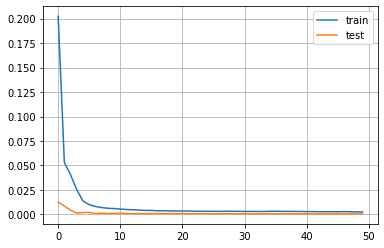

In [57]:
plot_history(history)

# Accessing Model Performance

In [58]:
def prediction(model,test_x,train_x, df):
    # Predict using the model
    predict =  model.predict(test_x)

    # Reshape test_x and train_x for visualization  and inverse-scaling purpose
    test_x = test_x.reshape((test_x.shape[0], test_x.shape[2]))
    train_x = train_x.reshape((train_x.shape[0], train_x.shape[2]))

    # Concatenate test_x with predicted value
    predict_ = np.concatenate((test_x, predict),axis = 1)

    # Inverse-scaling to get the real values
    predict_ = scaler.inverse_transform(predict_)
    original_ = scaler.inverse_transform(test)

    # Create dataframe to store the predicted and original values
    pred = pd.DataFrame()
    pred['dt'] = df['dt'][-test_x.shape[0]:]
    pred['Original'] = original_[:,-1]
    pred['Predicted'] = predict_[:,-1]

    # Calculate the error 
    pred['Error'] = pred['Original'] - pred['Predicted']
    
    # Create dataframe for visualization
    df = df[['dt','AverageTemperature']][:-test_x.shape[0]]
    df.columns = ['dt','Original']
    original = df.append(pred[['dt','Original']])
    df.columns = ['dt','Predicted']
    predicted = df.append(pred[['dt','Predicted']])
    original = original.merge(predicted, left_on = 'dt',right_on = 'dt')
    return pred, original

In [59]:
pred, original = prediction(model, test_x, train_x, df_global_monthly )

In [60]:
def plot_error(df):

    # Plotting the Current and Predicted values
    fig = px.line(title = 'Prediction vs. Actual')
    fig.add_scatter(x = df['dt'], y = df['Original'], name = 'Original', opacity = 0.7)
    fig.add_scatter(x = df['dt'], y = df['Predicted'], name = 'Predicted', opacity = 0.5)
    fig.show()

    fig = px.line(title = 'Error')
    fig = fig.add_scatter(x = df['dt'], y = df['Error'])
    fig.show()



In [61]:
def plot(df):
    # Plotting the Current and Predicted values
    fig = px.line(title = 'Prediction vs. Actual')
    fig.add_scatter(x = df['dt'], y = df['Original'], name = 'Original', opacity = 0.7)
    fig.add_scatter(x = df['dt'], y = df['Predicted'], name = 'Predicted', opacity = 0.5)
    fig.show()


In [62]:
plot(original)

In [63]:
plot_error(pred)

# Prepare data to train model for US data

In [64]:
# Modeling for US data
US_df = temperature_df[temperature_df['Country'] == 'United States'].reset_index(drop = True)
US_df

,dt,AverageTemperature,AverageTemperatureUncertainty,Country,year,Month
0,1768-09-01,15.420,2.880,United States,1768,9
1,1768-10-01,8.162,3.386,United States,1768,10
2,1768-11-01,1.591,3.783,United States,1768,11
3,1768-12-01,-2.882,4.979,United States,1768,12
4,1769-01-01,-3.952,4.856,United States,1769,1
...,...,...,...,...,...,...
2936,2013-05-01,14.073,0.178,United States,2013,5
2937,2013-06-01,20.198,0.236,United States,2013,6
2938,2013-07-01,22.074,0.152,United States,2013,7
2939,2013-08-01,21.168,0.249,United States,2013,8


In [65]:
US_df = US_df.drop(['Country', 'year'], axis = 1)

In [66]:
# Get the training data
US_df = prepare_data(US_df, 3)

In [67]:
US_df = US_df.dropna().reset_index(drop = True)

In [68]:
# Split the data
train = US_df[:int(0.9 * len(US_df))].drop(columns = 'dt').values

In [69]:
# Split the data
test = US_df[int(0.9 * len(US_df)):].drop(columns = 'dt').values

In [70]:
train.shape

(2643, 13)

In [71]:
# Scale the data
scaler = MinMaxScaler(feature_range = (0, 1))
train  = scaler.fit_transform(train)
test   = scaler.transform(test)

# train  = scaler.fit_transform(train[:, 0:2])
# test   = scaler.transform(test[:,0:2])

In [72]:
# Split the data into input features and targets
train_x, train_y = train[:,:-1], train[:,-1]
test_x, test_y = test[:,:-1], test[:,-1]

In [73]:
# reshape input to be 3D [samples, timesteps, features]
train_x = train_x.reshape((train_x.shape[0], 1, train_x.shape[1]))
test_x = test_x.reshape((test_x.shape[0], 1, test_x.shape[1]))
print(train_x.shape, train_y.shape, test_x.shape, test_y.shape)

(2643, 1, 12) (2643,) (294, 1, 12) (294,)


In [74]:
train_x

array([[[0.15449614, 0.93223547, 1.        , ..., 0.7562387 ,
         0.53492334, 0.72727273]],

       [[0.11931613, 0.90895325, 0.        , ..., 0.51760644,
         0.63070225, 0.81818182]],

       [[0.16100608, 0.61650577, 0.09090909, ..., 0.30156173,
         0.70584895, 0.90909091]],

       ...,

       [[0.19990136, 0.02101079, 1.        , ..., 0.78060168,
         0.01684649, 0.72727273]],

       [[0.14722999, 0.02593224, 0.        , ..., 0.55239191,
         0.0166572 , 0.81818182]],

       [[0.15663324, 0.01495362, 0.09090909, ..., 0.34489561,
         0.01022147, 0.90909091]]])

# Building and Training a LSTM Model for Predicting US Temperatures Trends

In [75]:
model = create_model(train_x)
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 1, 12)]           0         
                                                                 
 lstm_3 (LSTM)               (None, 1, 50)             12600     
                                                                 
 dropout_2 (Dropout)         (None, 1, 50)             0         
                                                                 
 lstm_4 (LSTM)               (None, 1, 50)             20200     
                                                                 
 dropout_3 (Dropout)         (None, 1, 50)             0         
                                                                 
 lstm_5 (LSTM)               (None, 50)                20200     
                                                                 
 dense_1 (Dense)             (None, 1)                 51  

In [76]:
# fit the network
history = model.fit(train_x, train_y, epochs = 50, batch_size = 72, validation_data = (test_x, test_y), shuffle = False)

Epoch 1/50
37/37 [==============================] - 13s 112ms/step - loss: 0.2242 - val_loss: 0.1105
Epoch 2/50
37/37 [==============================] - 0s 10ms/step - loss: 0.0812 - val_loss: 0.0683
Epoch 3/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0461 - val_loss: 0.0245
Epoch 4/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0156 - val_loss: 0.0043
Epoch 5/50
37/37 [==============================] - 0s 10ms/step - loss: 0.0127 - val_loss: 0.0027
Epoch 6/50
37/37 [==============================] - 0s 11ms/step - loss: 0.0097 - val_loss: 0.0018
Epoch 7/50
37/37 [==============================] - 0s 13ms/step - loss: 0.0088 - val_loss: 0.0017
Epoch 8/50
37/37 [==============================] - 0s 8ms/step - loss: 0.0077 - val_loss: 0.0016
Epoch 9/50
37/37 [==============================] - 0s 9ms/step - loss: 0.0078 - val_loss: 0.0018
Epoch 10/50
37/37 [==============================] - 0s 10ms/step - loss: 0.0077 - val_loss: 0.0014
Epoch 11/50

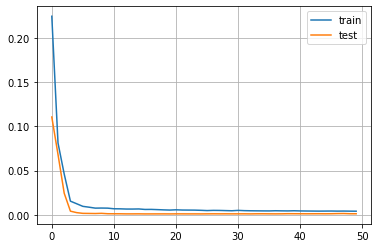

In [77]:
plot_history(history)

# Accessing Model Performance for US Data

In [78]:
pred, original = prediction(model, test_x, train_x, US_df )

In [79]:
plot(original)

In [80]:
plot_error(pred)